# 6. 프로젝트: 자율주행 보조 시스템 만들기

## 루브릭

|평가문항|	상세기준|
|:-------|:-------|
|1. KITTI 데이터셋에 대한 분석이 체계적으로 진행되었다.|KITTI 데이터셋 구조와 내용을 파악하고 이를 토대로 필요한 데이터셋 가공을 정상 진행하였다.|
|2. RetinaNet 학습이 정상적으로 진행되어 object detection 결과의 시각화까지 진행되었다.|바운딩박스가 정확히 표시된 시각화된 이미지를 생성하였다.|
|3. 자율주행 Object Detection 테스트시스템 적용결과 만족스러운 정확도 성능을 달성하였다.|테스트 수행결과 90% 이상의 정확도를 보였다.|

## 0. Object Detection 시스템 만들기

### 필요한 라이브러리 불러오기

In [1]:
# TensorFlow and tf.keras
import tensorflow as tf
from tensorflow import keras

# Helper libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

import tensorflow_datasets as tfds

import copy
import cv2
from PIL import Image, ImageDraw

###  KITTI 데이터셋에 대한 분석

In [2]:
import urllib3
urllib3.disable_warnings()

# KITTI 데이터셋을 다운로드
(ds_train, ds_test), ds_info = tfds.load(
    'kitti',
    split=['train', 'test'],
    shuffle_files=True,
    with_info=True,
)

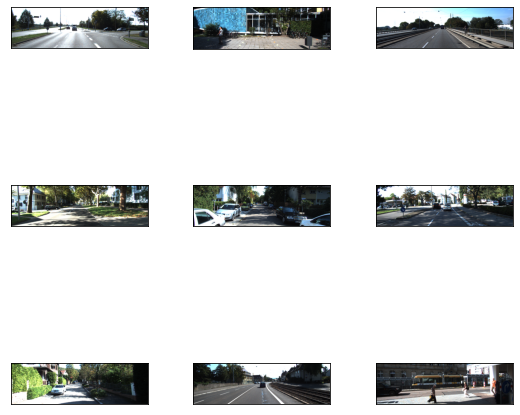

In [3]:
# 다운로드한 데이터셋 이미지 확인
fig = tfds.show_examples(ds_train, ds_info)

#### 데이터셋 정보 확인

In [4]:
# 불러온 데이터셋의 정보 확인
ds_info

tfds.core.DatasetInfo(
    name='kitti',
    full_name='kitti/3.2.0',
    description="""
    Kitti contains a suite of vision tasks built using an autonomous driving
    platform. The full benchmark contains many tasks such as stereo, optical flow,
    visual odometry, etc. This dataset contains the object detection dataset,
    including the monocular images and bounding boxes. The dataset contains 7481
    training images annotated with 3D bounding boxes. A full description of the
    annotations can be found in the readme of the object development kit readme on
    the Kitti homepage.
    """,
    homepage='http://www.cvlibs.net/datasets/kitti/',
    data_path='/home/aiffel-d34j/tensorflow_datasets/kitti/3.2.0',
    download_size=11.71 GiB,
    dataset_size=5.27 GiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=tf.uint8),
        'image/file_name': Text(shape=(), dtype=tf.string),
        'objects': Sequence({
            'alpha': tf.float32,
    

In [5]:
# 피쳐 정보 확인
ds_info.features

FeaturesDict({
    'image': Image(shape=(None, None, 3), dtype=tf.uint8),
    'image/file_name': Text(shape=(), dtype=tf.string),
    'objects': Sequence({
        'alpha': tf.float32,
        'bbox': BBoxFeature(shape=(4,), dtype=tf.float32),
        'dimensions': Tensor(shape=(3,), dtype=tf.float32),
        'location': Tensor(shape=(3,), dtype=tf.float32),
        'occluded': ClassLabel(shape=(), dtype=tf.int64, num_classes=4),
        'rotation_y': tf.float32,
        'truncated': tf.float32,
        'type': ClassLabel(shape=(), dtype=tf.int64, num_classes=8),
    }),
})

In [6]:
# 피쳐의 object 목록 확인
print(sorted([key for key in ds_info.features['objects'].keys()]))

['alpha', 'bbox', 'dimensions', 'location', 'occluded', 'rotation_y', 'truncated', 'type']


* 딕셔너리 key 출력 : [참고](https://junho85.pe.kr/671)

In [7]:
# 데이터셋 구성 확인
ds_info.splits

{'test': <SplitInfo num_examples=711, num_shards=4>,
 'train': <SplitInfo num_examples=6347, num_shards=64>,
 'validation': <SplitInfo num_examples=423, num_shards=4>}

In [8]:
# train / validation / test dataset 갯수 확인
print('학습 데이터셋 갯수 :', ds_info.splits['train'].num_examples)
print('검증 데이터셋 갯수 :', ds_info.splits['validation'].num_examples)
print('테스트 데이터셋 갯수 :', ds_info.splits['test'].num_examples)

학습 데이터셋 갯수 : 6347
검증 데이터셋 갯수 : 423
테스트 데이터셋 갯수 : 711


#### 데이터셋 이미지 및 객체 정보 확인

------Example------
['image', 'image/file_name', 'objects']
------objects------
{'alpha': <tf.Tensor: shape=(15,), dtype=float32, numpy=
array([-1.59,  2.16,  2.26, -1.73,  0.18,  2.01, -2.16, -2.32, -2.31,
       -2.21, -2.38, -1.7 , -1.69, -1.55,  2.  ], dtype=float32)>, 'bbox': <tf.Tensor: shape=(15, 4), dtype=float32, numpy=
array([[0.36784   , 0.47198874, 0.5303467 , 0.5323349 ],
       [0.34498668, 0.02566023, 0.54682666, 0.17231885],
       [0.11253333, 0.8630676 , 0.5584267 , 0.99919486],
       [0.33954668, 0.5711916 , 0.6306667 , 0.66647345],
       [0.21461333, 0.28886473, 0.5917067 , 0.3221417 ],
       [0.42656   , 0.1871095 , 0.57045335, 0.26768115],
       [0.37618667, 0.28492755, 0.55861336, 0.39438808],
       [0.40565333, 0.30672303, 0.5417333 , 0.40779388],
       [0.42234668, 0.33293074, 0.5394667 , 0.42726249],
       [0.45477334, 0.38108695, 0.5499733 , 0.4429871 ],
       [0.49373335, 0.41223833, 0.55517334, 0.4595169 ],
       [0.43794668, 0.5479066 , 0.5427733 

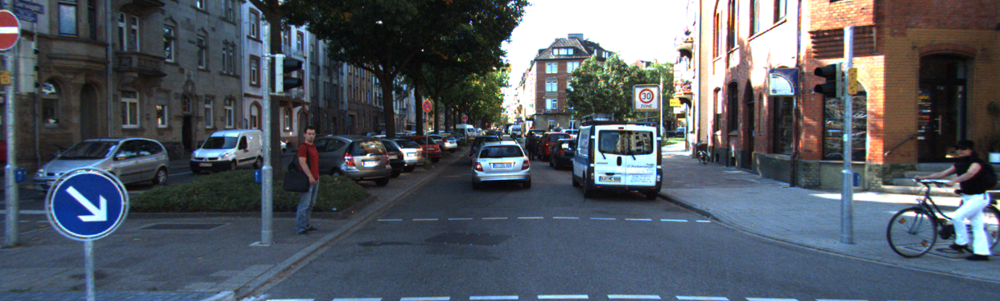

In [9]:
TakeDataset = ds_train.take(1)

# 데이터셋 이미지 및 객체 정보 확인
for example in TakeDataset:  
    print('------Example------')
    print(list(example.keys()))       # example is `{'image': tf.Tensor, 'label': tf.Tensor}`
    image = example["image"]
    filename = example["image/file_name"].numpy().decode('utf-8')
    objects = example["objects"]

print('------objects------')
print(objects)

# 데이터셋 이미지 출력
img = Image.fromarray(image.numpy())
img

**objects** 
  - 'alpha' 
  - **'bbox'**
  - **'dimensions'**
  - **'location'**
  - 'occluded'
  - 'truncated'
  - 'type'

* `ds_train.take(1)` :
* `example.keys()` :
* `example["image"]` :
* `example["image/file_name"].numpy().decode('utf-8')`
* `Image.fromarray(image.numpy())` : 

In [10]:
print(objects.keys())

dict_keys(['alpha', 'bbox', 'dimensions', 'location', 'occluded', 'rotation_y', 'truncated', 'type'])


#### 바운딩 박스 그리기

width: 1242  height: 375
(15, 4)
[586.21 237.06 661.16 176.12]
[ 31.87    245.62999 214.02    169.94   ]
[1071.9299  332.8    1241.      165.59  ]
[709.42 247.67 827.76 138.5 ]
[358.77    294.52    400.1     153.10999]
[232.39 215.04 332.46 161.08]
[353.88    233.93    489.83    165.51999]
[380.95 222.88 506.48 171.85]
[413.49997 216.62    530.66003 172.7    ]
[473.31    204.45999 550.19    168.76001]
[512.      189.84999 570.72003 166.81   ]
[680.49994 210.76999 739.02    171.46   ]
[666.79004 199.95    714.14    162.56   ]
[583.31 207.46 625.16 169.27]
[288.22 196.89 358.95 166.33]
<PIL.Image.Image image mode=RGB size=1242x375 at 0x7FDC20023490>


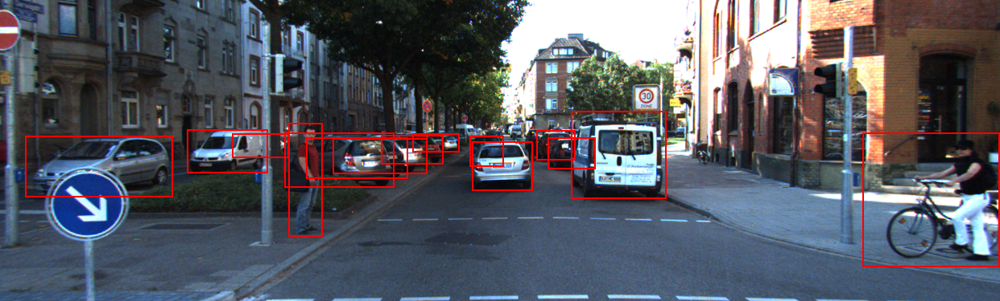

In [11]:
# 이미지 위에 바운딩 박스를 그려 화면에 표시해 주세요.
def visualize_bbox(input_image, object_bbox):
    input_image = copy.deepcopy(input_image)
    draw = ImageDraw.Draw(input_image)

    # 바운딩 박스 좌표(x_min, x_max, y_min, y_max) 구하기
    width, height = img.size
    print('width:', width, ' height:', height)
    print(object_bbox.shape)
    x_min = object_bbox[:,1] * width
    x_max = object_bbox[:,3] * width
    y_min = height - object_bbox[:,0] * height
    y_max = height - object_bbox[:,2] * height
    
    # 바운딩 박스 그리기
    rects = np.stack([x_min, y_min, x_max, y_max], axis=1)
    for _rect in rects:
        print(_rect)
        draw.rectangle(_rect, outline=(255,0,0), width=2)
    print(input_image)
    return input_image    

visualize_bbox(img, objects['bbox'].numpy())

### 데이터 포맷 변경

#### 클래스 및 바운딩 박스 정보 추출

In [12]:
import os

data_dir = os.getenv('HOME')+'/aiffel/object_detection/data'
img_dir = os.getenv('HOME')+'/kitti_images'
train_csv_path = data_dir + '/kitti_train.csv'
test_csv_path = data_dir + '/kitti_test.csv'

In [13]:
# KITTI 데이터셋 ds_train을 파싱해서 dataframe으로 변환하는 parse_dataset 함수를 구현해 주세요.
def parse_dataset(dataset, img_dir="kitti_images", total=0):
    if not os.path.exists(img_dir):
        os.mkdir(img_dir)

    type_class_map = {
        0: "car",
        1: "car",
        2: "car",
        3: "person",
        4: "person",
        5: "person",
    }

    df = pd.DataFrame(columns=["img_path", "x1", "y1", "x2", "y2", "class_name"])
    for item in tqdm(dataset, total=total):
        # 코드 구현
        filename = item['image/file_name'].numpy().decode('utf-8')
        img_path = os.path.join(img_dir, filename)

        img = Image.fromarray(item['image'].numpy())
        img.save(img_path)
        object_bbox = item['objects']['bbox']
        object_type = item['objects']['type'].numpy()
        width, height = img.size

        # tf.dataset의 bbox좌표가 0과 1사이로 normalize된 좌표이므로 이를 pixel좌표로 변환합니다.
        x_min = object_bbox[:,1] * width
        x_max = object_bbox[:,3] * width
        y_min = height - object_bbox[:,2] * height
        y_max = height - object_bbox[:,0] * height

        # 한 이미지에 있는 여러 Object들을 한 줄씩 pandas.DataFrame에 append합니다.
        rects = np.stack([x_min, y_min, x_max, y_max], axis=1).astype(np.int)
        for i, _rect in enumerate(rects):
            _type = object_type[i]
            if _type not in type_class_map.keys():
                continue
            df = df.append({
                "img_path": img_path,
                "x1": _rect[0],
                "y1": _rect[1],
                "x2": _rect[2],
                "y2": _rect[3],
                "class_name": type_class_map[_type]
            }, ignore_index=True)
            break
            
    return df

#### dataframe 생성

In [14]:
# 학습 데이터셋에 대해서 dataframe 생성
df_train = parse_dataset(ds_train, img_dir, total=ds_info.splits['train'].num_examples)
df_train.to_csv(train_csv_path, sep=',',index = False, header=False)    # CSV 파일로 저장

100%|██████████| 6347/6347 [13:22<00:00,  7.91it/s]


In [15]:
# 테스트 데이터셋에 대해서 dataframe 생성
df_test = parse_dataset(ds_test, img_dir, total=ds_info.splits['test'].num_examples)
df_test.to_csv(test_csv_path, sep=',',index = False, header=False)      # CSV 파일로 저장

100%|██████████| 711/711 [01:34<00:00,  7.56it/s]


#### 클래스 맵핑

In [16]:
# 자동차와 사람을 구별하기 위한 클래스 맵핑 함수
class_txt_path = data_dir + '/classes.txt'    

def save_class_format(path="./classes.txt"):
    class_type_map = {
        "car" : 0,
        "person": 1
    }
    with open(path, mode='w', encoding='utf-8') as f:
        for k, v in class_type_map.items():
            f.write(f"{k},{v}\n")

save_class_format(class_txt_path)

### 학습 셋팅 및 훈련

#### RetinaNet 훈련

학습이 잘 되기 위해서는 환경에 따라 batch_size나 worker, epoch 조절

In [17]:
# RetinaNet 훈련이 시작됩니다!! 50epoch 훈련에 1시간 이상 소요될 수 있습니다. 
!cd ~/aiffel/object_detection && python keras-retinanet/keras_retinanet/bin/train.py --gpu 0 --multiprocessing --workers 4 --batch-size 2 --epochs 50 --steps 195 csv data/kitti_train.csv data/classes.txt

2021-04-27 00:04:59.430285: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-04-27 00:05:01.393237: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-27 00:05:01.395686: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-04-27 00:05:01.419851: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-27 00:05:01.420226: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce RTX 2070 computeCapability: 7.5
coreClock: 1.455GHz coreCount: 36 deviceMemorySize: 7.79GiB deviceMemoryBandwidth: 327.88GiB/s
2021-04-27 00:05:01.420244: I tensorflow/stream_executor/platform/default/d

bn2c_branch2c (BatchNormalizati (None, None, None, 2 1024        res2c_branch2c[0][0]             
__________________________________________________________________________________________________
res2c (Add)                     (None, None, None, 2 0           bn2c_branch2c[0][0]              
                                                                 res2b_relu[0][0]                 
__________________________________________________________________________________________________
res2c_relu (Activation)         (None, None, None, 2 0           res2c[0][0]                      
__________________________________________________________________________________________________
res3a_branch2a (Conv2D)         (None, None, None, 1 32768       res2c_relu[0][0]                 
__________________________________________________________________________________________________
bn3a_branch2a (BatchNormalizati (None, None, None, 1 512         res3a_branch2a[0][0]             
__________

2021-04-27 00:05:05.514040: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2021-04-27 00:05:05.514571: I tensorflow/core/platform/profile_utils/cpu_utils.cc:112] CPU Frequency: 2599990000 Hz
Epoch 1/50
2021-04-27 00:05:11.549986: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudnn.so.7
2021-04-27 00:05:12.650323: W tensorflow/stream_executor/gpu/asm_compiler.cc:63] Running ptxas --version returned 256
2021-04-27 00:05:12.697689: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] Internal: ptxas exited with non-zero error code 256, output: 
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.
2021-04-27 00:05:13.144269: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.10
2021-04-27 00:05:22.960010: W tensor

195/195 [==============================] - 56s 285ms/step - loss: 1.4738 - regression_loss: 1.1483 - classification_loss: 0.3256

Epoch 00011: saving model to ./snapshots/resnet50_csv_11.h5
Epoch 12/50
195/195 [==============================] - 56s 284ms/step - loss: 1.3806 - regression_loss: 1.0706 - classification_loss: 0.3100

Epoch 00012: saving model to ./snapshots/resnet50_csv_12.h5

Epoch 00012: ReduceLROnPlateau reducing learning rate to 9.999999974752428e-08.
Epoch 13/50
195/195 [==============================] - 56s 284ms/step - loss: 1.2751 - regression_loss: 0.9891 - classification_loss: 0.2860

Epoch 00013: saving model to ./snapshots/resnet50_csv_13.h5
Epoch 14/50
195/195 [==============================] - 56s 284ms/step - loss: 1.3020 - regression_loss: 1.0104 - classification_loss: 0.2916

Epoch 00014: saving model to ./snapshots/resnet50_csv_14.h5
Epoch 15/50
195/195 [==============================] - 56s 284ms/step - loss: 1.3241 - regression_loss: 0.9952 - classifica

195/195 [==============================] - 56s 284ms/step - loss: 1.4217 - regression_loss: 1.0922 - classification_loss: 0.3294

Epoch 00031: saving model to ./snapshots/resnet50_csv_31.h5
Epoch 32/50
195/195 [==============================] - 56s 284ms/step - loss: 1.2749 - regression_loss: 0.9918 - classification_loss: 0.2831

Epoch 00032: saving model to ./snapshots/resnet50_csv_32.h5

Epoch 00032: ReduceLROnPlateau reducing learning rate to 9.999998977483754e-17.
Epoch 33/50
195/195 [==============================] - 56s 284ms/step - loss: 1.2857 - regression_loss: 1.0014 - classification_loss: 0.2842

Epoch 00033: saving model to ./snapshots/resnet50_csv_33.h5
Epoch 34/50
195/195 [==============================] - 56s 285ms/step - loss: 1.3311 - regression_loss: 1.0220 - classification_loss: 0.3091

Epoch 00034: saving model to ./snapshots/resnet50_csv_34.h5

Epoch 00034: ReduceLROnPlateau reducing learning rate to 9.999998845134856e-18.
Epoch 35/50
195/195 [=====================

#### 학습된 모델을 케라스 모델로 변환

- keras-retinanet에서 convert_model.py 이용하여 
- 50에폭 훈련후 저장된 resnet50_csv_50.h5 파일을 resnet50_csv_50_infer.h5 파일로 변경

In [18]:
# 학습된 모델을 추론을 위해 실행할 수 있는 케라스 모델로 변환
!cd ~/aiffel/object_detection && python keras-retinanet/keras_retinanet/bin/convert_model.py snapshots/resnet50_csv_50.h5 snapshots/resnet50_csv_50_infer.h5

2021-04-27 00:53:34.757183: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-04-27 00:53:36.586704: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-27 00:53:36.589371: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-04-27 00:53:36.627569: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-27 00:53:36.629031: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce RTX 2070 computeCapability: 7.5
coreClock: 1.455GHz coreCount: 36 deviceMemorySize: 7.79GiB deviceMemoryBandwidth: 327.88GiB/s
2021-04-27 00:53:36.629115: I tensorflow/stream_executor/platform/default/d

### 시각화

In [19]:
%matplotlib inline

# automatically reload modules when they have changed
%load_ext autoreload
%autoreload 2

# import keras
import keras

# import keras_retinanet
from keras_retinanet import models
from keras_retinanet.models import load_model
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color
from keras_retinanet.utils.gpu import setup_gpu

# import miscellaneous modules
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
import time

gpu = '0'
setup_gpu(gpu)

dir_path = os.getenv('HOME') + '/aiffel/object_detection/'
model_path = os.path.join(dir_path, 'snapshots', 'resnet50_csv_50_infer.h5')
model = load_model(model_path, backbone_name='resnet50')

Physical devices cannot be modified after being initialized
1 Physical GPUs, 1 Logical GPUs


* `tf.keras.models.load_model(filepath, custom_objects=None, compile=True, options=None)` : 
  - Loads a model saved via model.save()
  - [참고: load_model](https://www.tensorflow.org/api_docs/python/tf/keras/models/load_model)
  - [참고: Keras-RetinaNet을 이용한 모델 로딩 및 예측](http://machinelearningkorea.com/2019/12/15/keras-retinanet을-이용한-모델-로딩-및-예측/)

#### 변환한 모델로부터 추론 및 시각화

In [55]:
# inference_on_image 함수를 구현해 주세요.
def inference_on_image(model, img_path="./test_set/go_1.png", visualize=True, limit_score=0.5):
    # load image
    image = read_image_bgr(img_path)

    # copy image to draw on
    draw = image.copy()
    draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

    color_map = {
        0: (0, 0, 255), # blue
        1: (255, 0, 0)  # red
    }

    # preprocess image for network
    image = preprocess_image(image)
    image, scale = resize_image(image)

    # process image
    boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))

    # correct for image scale
    boxes /= scale

    # visualize detections
    if  visualize:
        for box, score, label in zip(boxes[0], scores[0], labels[0]):
            print('box:', box)
            print('score:', score)
            print('label:', label)
            if score < limit_score:
                break
                
            b = box.astype(int)
            draw_box(draw, b, color=color_map[label])

            caption = "{:.3f}".format(score)
            draw_caption(draw, b, caption)

        plt.figure(figsize=(15, 15))
        plt.axis('off')
        plt.imshow(draw)
        plt.show()            
        
    return 

* [참고: Keras RetinaNet](https://github.com/fizyr/keras-retinanet)
* [참고: Run detection on example](https://notebook.community/delftrobotics/keras-retinanet/examples/ResNet50RetinaNet)
* [참고: TensorFlow Hub Object Detection Colab](https://www.tensorflow.org/hub/tutorials/tf2_object_detection)


* `preprocess_image()` :
* `resize_image()` : 
* `model.predict_on_batch()` : 하나의 샘플 배치에 대한 예측 값을 반환
  - [참고](https://keras.io/ko/models/sequential/)
* `np.expand_dims(image, axis=0)` :

box: [594.1475  175.3645  624.5516  205.40355]
score: 0.612082
label: 0
box: [196.61952 131.23344 332.40222 233.99141]
score: 0.28354177
label: 0
box: [583.55365 173.5095  613.16864 203.23845]
score: 0.23342271
label: 0
box: [604.9146  174.56929 633.19653 204.22461]
score: 0.20913397
label: 0
box: [596.7321  168.0184  626.707   196.39116]
score: 0.1452497
label: 0


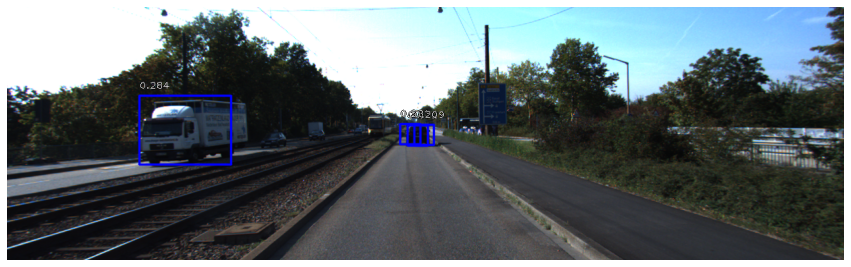

In [60]:
import os

# Go 이미지로 추론
img_path = os.getenv('HOME')+'/aiffel/object_detection/test_set/go_1.png'
inference_on_image(model, img_path=img_path, limit_score=0.2)

box: [547.80554 162.39705 574.1965  187.05312]
score: 0.19443947
label: 0
box: [541.419   165.89252 567.94995 190.03516]
score: 0.19161423
label: 0
box: [804.8731  141.94344 883.0659  175.73015]
score: 0.17735744
label: 0
box: [528.8555  164.02405 558.048   184.86443]
score: 0.12408925
label: 0


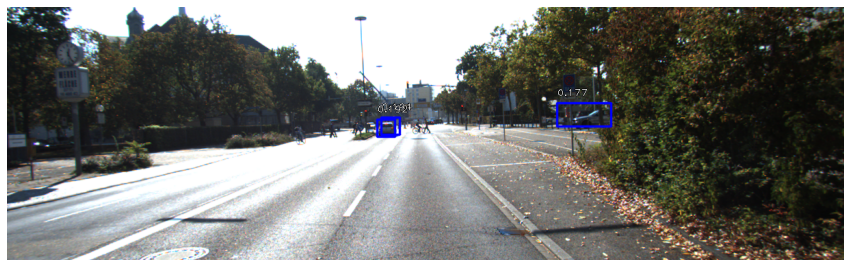

In [64]:
import os

# Go 이미지로 추론
img_path = os.getenv('HOME')+'/aiffel/object_detection/test_set/go_3.png'
inference_on_image(model, img_path=img_path, limit_score=0.15)

box: [774.05774 148.45802 840.9801  309.82446]
score: 0.6078683
label: 1
box: [766.1164  150.93613 843.325   303.14734]
score: 0.16877495
label: 0
box: [748.50964 134.11826 875.4377  319.6598 ]
score: 0.16342187
label: 1
box: [753.27594 182.80643 863.9526  273.89832]
score: 0.122988634
label: 0
box: [763.92957 153.55618 821.97015 279.25168]
score: 0.099624366
label: 1


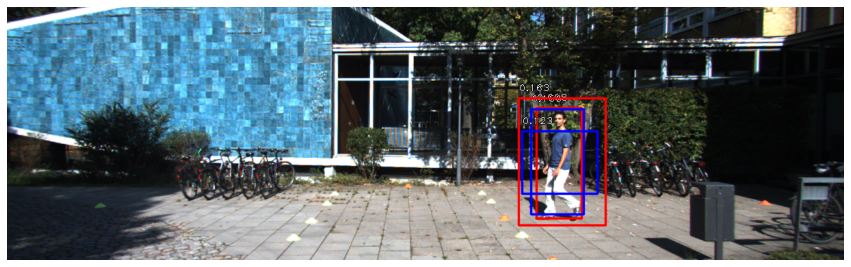

In [58]:
# Stop 이미지로 추론
img_path = os.getenv('HOME')+'/aiffel/object_detection/test_set/stop_1.png'
inference_on_image(model, img_path=img_path, limit_score=0.1)

#### limit_score=0.5

stop_5.png
box: [ 894.0435   189.20415 1241.0684   370.1611 ]
score: 0.486451
label: 0


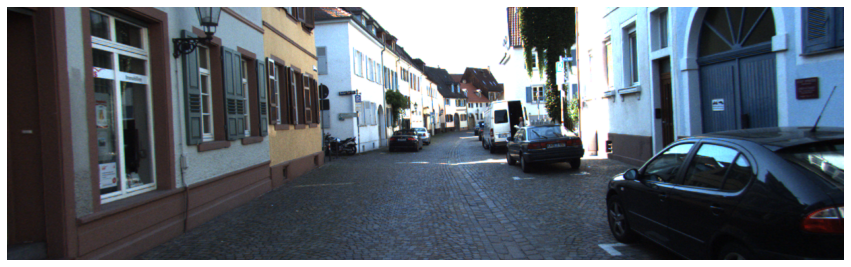

go_1.png
box: [594.1475  175.3645  624.5516  205.40355]
score: 0.612082
label: 0
box: [196.61952 131.23344 332.40222 233.99141]
score: 0.28354177
label: 0


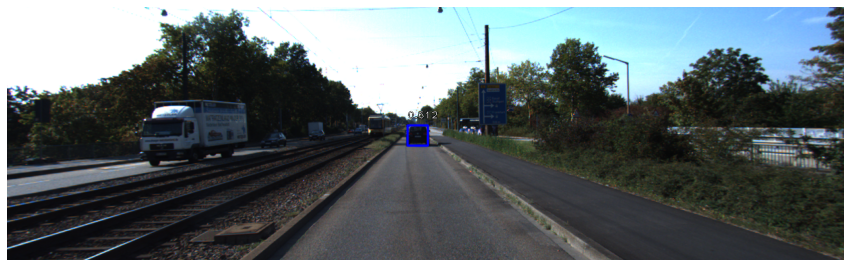

go_2.png
box: [625.46985 175.97823 666.6799  212.09056]
score: 0.6243944
label: 0
box: [517.93207 175.27269 570.73627 214.57968]
score: 0.20294568
label: 0


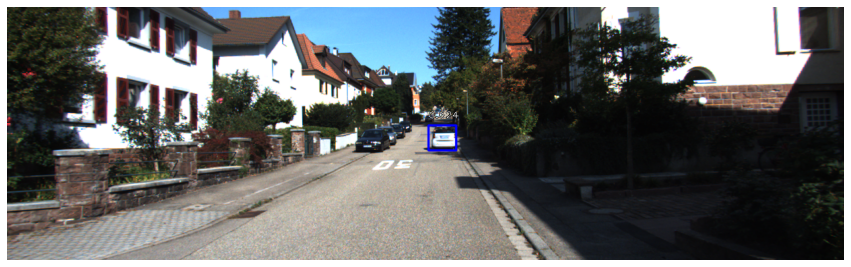

go_3.png
box: [547.80554 162.39705 574.1965  187.05312]
score: 0.19443947
label: 0


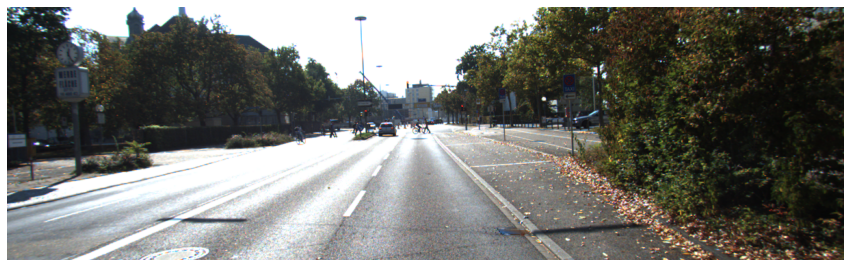

stop_3.png
box: [  0.      199.45767 314.24084 367.24814]
score: 0.71496505
label: 0
box: [757.5385  162.30478 884.85315 209.83275]
score: 0.4207703
label: 0


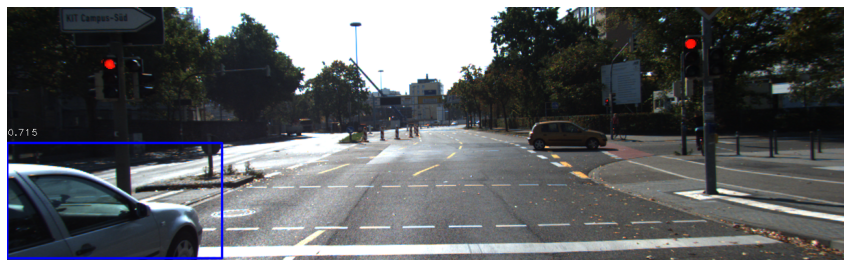

stop_4.png
box: [ 717.19946   91.04299 1071.1683   355.6579 ]
score: 0.33097196
label: 0


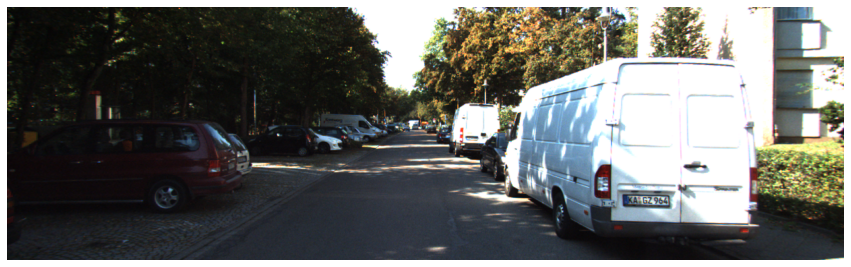

stop_1.png
box: [774.05774 148.45802 840.9801  309.82446]
score: 0.6078683
label: 1
box: [766.1164  150.93613 843.325   303.14734]
score: 0.16877495
label: 0


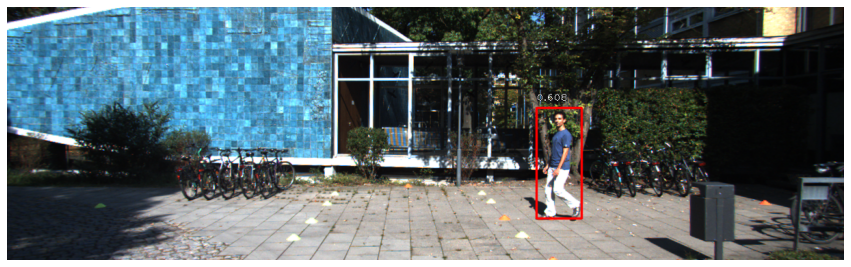

go_5.png
box: [ 10.051124 191.395    244.33957  307.4207  ]
score: 0.24523458
label: 0


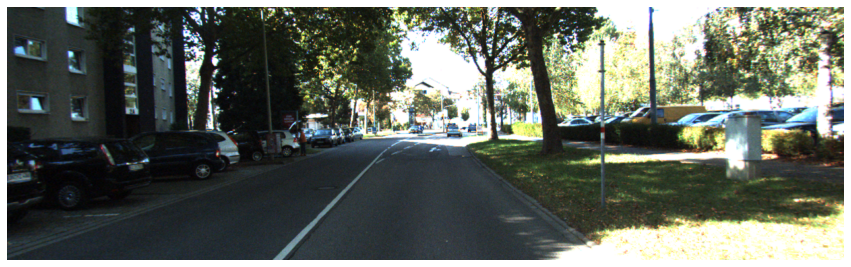

stop_2.png
box: [418.65976 165.71579 496.65778 333.7146 ]
score: 0.56915
label: 1
box: [415.21423 174.31871 500.57788 330.32516]
score: 0.24791689
label: 0


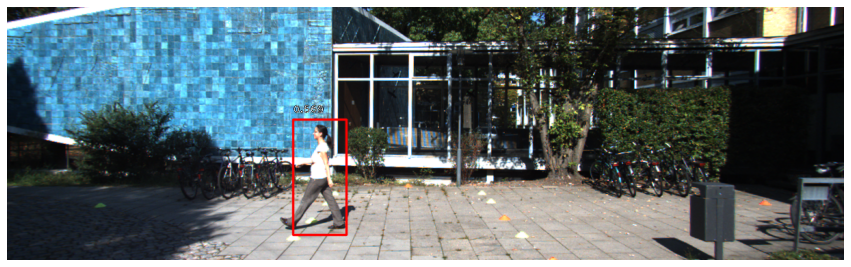

go_4.png
box: [695.80273 170.54253 789.76154 250.8625 ]
score: 0.5003097
label: 0
box: [680.1516  143.90611 809.6319  263.25494]
score: 0.12884207
label: 0


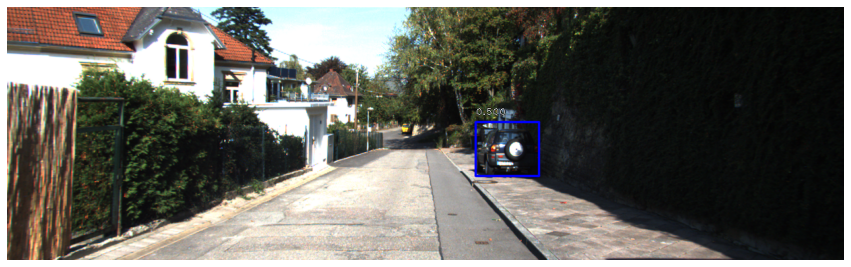

In [65]:
work_dir = os.getenv('HOME')+'/aiffel/object_detection/test_set/'
# work_dir 디렉토리에 있는 모든 파일(디렉토리) 리스트
file_list = os.listdir(work_dir)
# file_list에서 파일명이 .png로 끝나는 데이터만 file_list_png에 다시 정의
file_list_png = [file for file in file_list if file.endswith(".png")]

for image_file in file_list_png:
    print(image_file)
    image_path = work_dir + image_file
    # print(image_path)
    inference_on_image(model, img_path=image_path, limit_score=0.5)

#### limit_score=0.4

stop_5.png
box: [ 894.0435   189.20415 1241.0684   370.1611 ]
score: 0.486451
label: 0
box: [565.7537  178.36168 612.40344 216.80493]
score: 0.36258483
label: 0


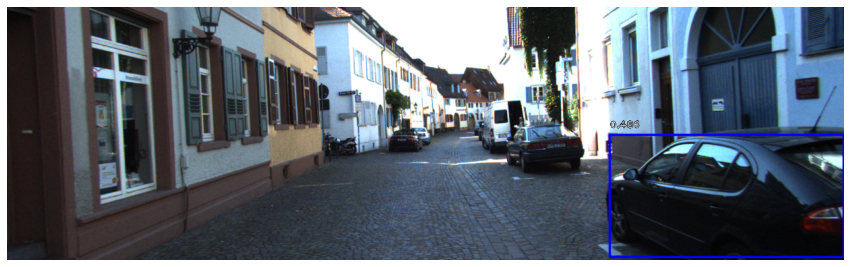

go_1.png
box: [594.1475  175.3645  624.5516  205.40355]
score: 0.612082
label: 0
box: [196.61952 131.23344 332.40222 233.99141]
score: 0.28354177
label: 0


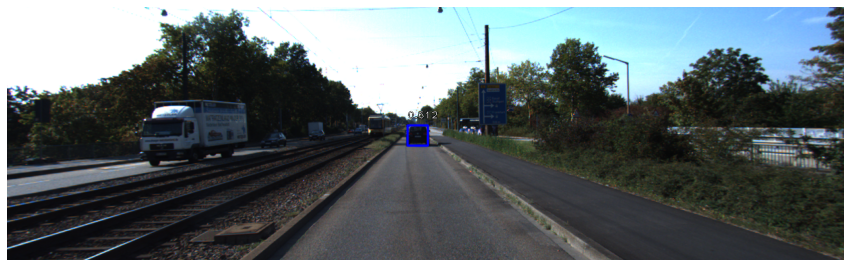

go_2.png
box: [625.46985 175.97823 666.6799  212.09056]
score: 0.6243944
label: 0
box: [517.93207 175.27269 570.73627 214.57968]
score: 0.20294568
label: 0


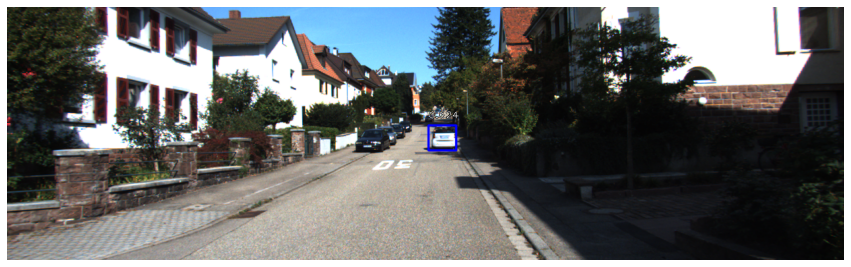

go_3.png
box: [547.80554 162.39705 574.1965  187.05312]
score: 0.19443947
label: 0


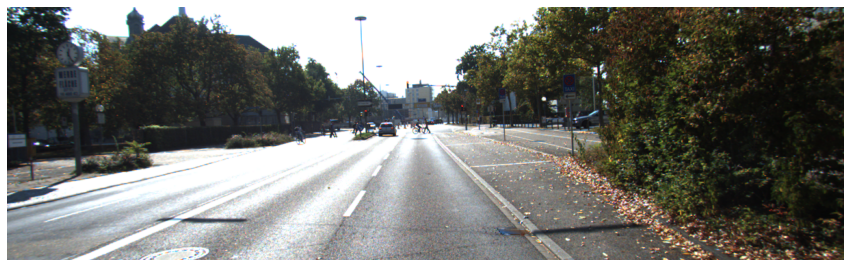

stop_3.png
box: [  0.      199.45767 314.24084 367.24814]
score: 0.71496505
label: 0
box: [757.5385  162.30478 884.85315 209.83275]
score: 0.4207703
label: 0
box: [747.9115  133.59299 900.7863  217.73022]
score: 0.15102558
label: 0


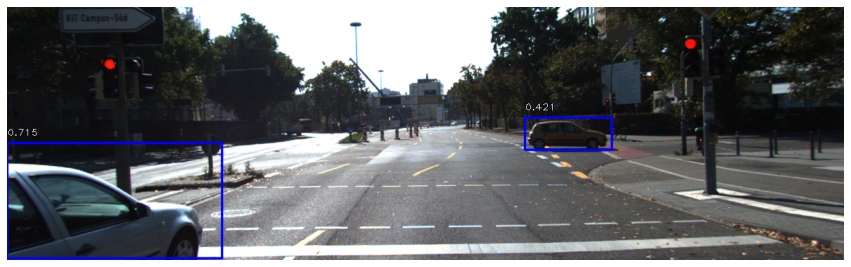

stop_4.png
box: [ 717.19946   91.04299 1071.1683   355.6579 ]
score: 0.33097196
label: 0


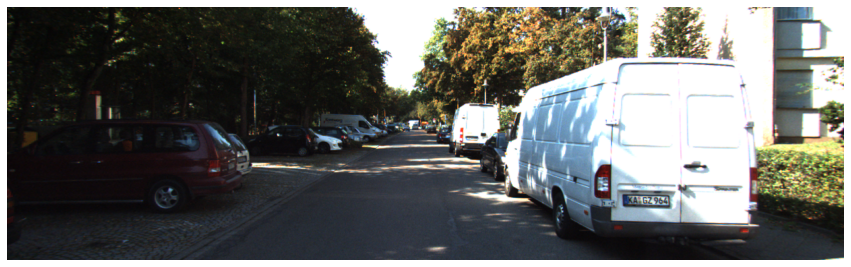

stop_1.png
box: [774.05774 148.45802 840.9801  309.82446]
score: 0.6078683
label: 1
box: [766.1164  150.93613 843.325   303.14734]
score: 0.16877495
label: 0


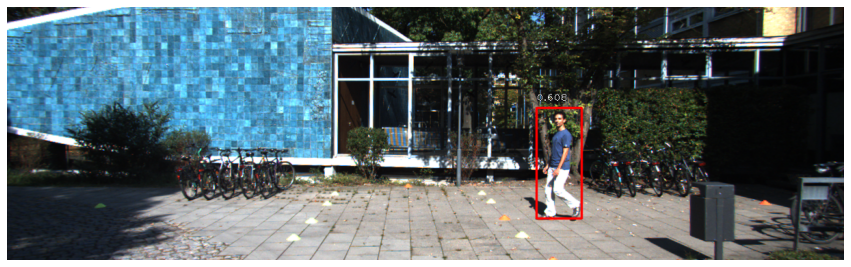

go_5.png
box: [ 10.051124 191.395    244.33957  307.4207  ]
score: 0.24523458
label: 0


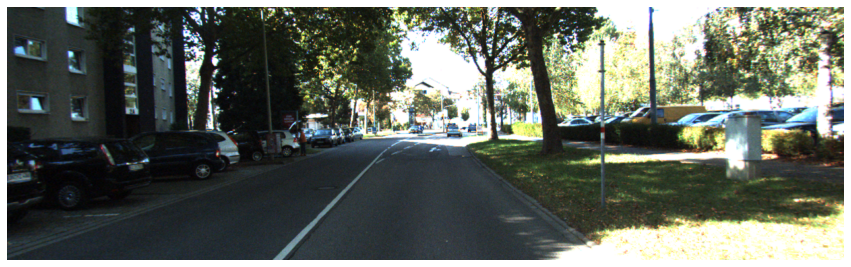

stop_2.png
box: [418.65976 165.71579 496.65778 333.7146 ]
score: 0.56915
label: 1
box: [415.21423 174.31871 500.57788 330.32516]
score: 0.24791689
label: 0


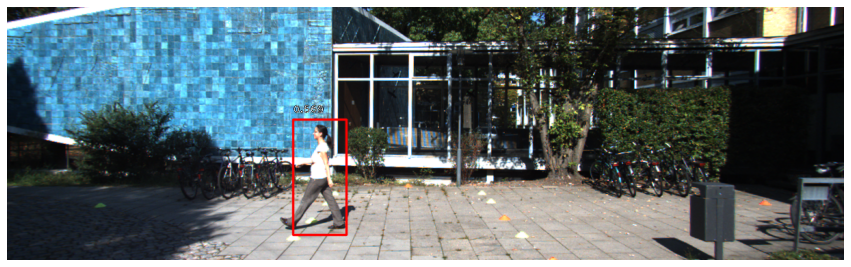

go_4.png
box: [695.80273 170.54253 789.76154 250.8625 ]
score: 0.5003097
label: 0
box: [680.1516  143.90611 809.6319  263.25494]
score: 0.12884207
label: 0


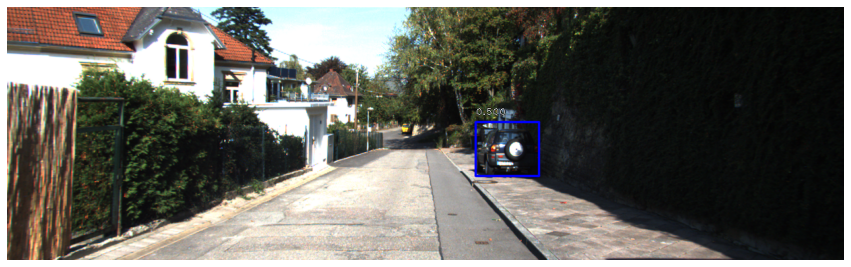

In [66]:
work_dir = os.getenv('HOME')+'/aiffel/object_detection/test_set/'
# work_dir 디렉토리에 있는 모든 파일(디렉토리) 리스트
file_list = os.listdir(work_dir)
# file_list에서 파일명이 .png로 끝나는 데이터만 file_list_png에 다시 정의
file_list_png = [file for file in file_list if file.endswith(".png")]

for image_file in file_list_png:
    print(image_file)
    image_path = work_dir + image_file
    # print(image_path)
    inference_on_image(model, img_path=image_path, limit_score=0.4)

#### limit_score=0.3

stop_5.png
box: [ 894.0435   189.20415 1241.0684   370.1611 ]
score: 0.486451
label: 0
box: [565.7537  178.36168 612.40344 216.80493]
score: 0.36258483
label: 0
box: [737.1734  163.96396 855.4426  242.52092]
score: 0.31953755
label: 0
box: [ 992.1412   133.3376  1241.0684   315.31183]
score: 0.15823211
label: 0


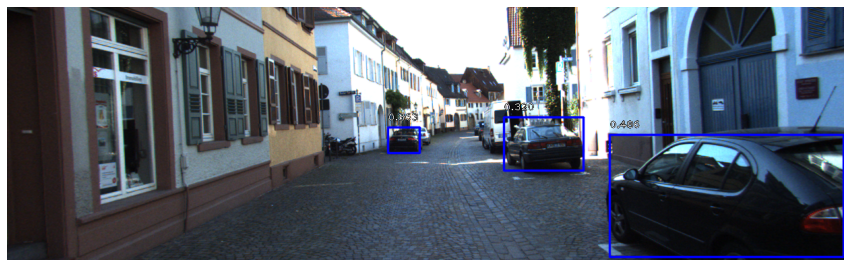

go_1.png
box: [594.1475  175.3645  624.5516  205.40355]
score: 0.612082
label: 0
box: [196.61952 131.23344 332.40222 233.99141]
score: 0.28354177
label: 0


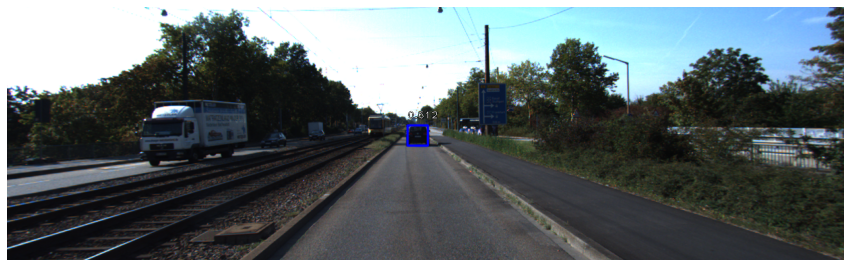

go_2.png
box: [625.46985 175.97823 666.6799  212.09056]
score: 0.6243944
label: 0
box: [517.93207 175.27269 570.73627 214.57968]
score: 0.20294568
label: 0


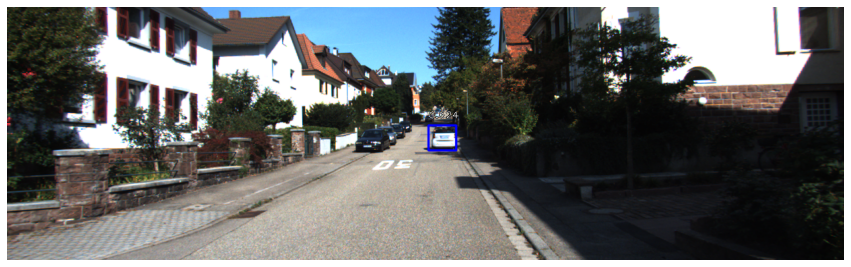

go_3.png
box: [547.80554 162.39705 574.1965  187.05312]
score: 0.19443947
label: 0


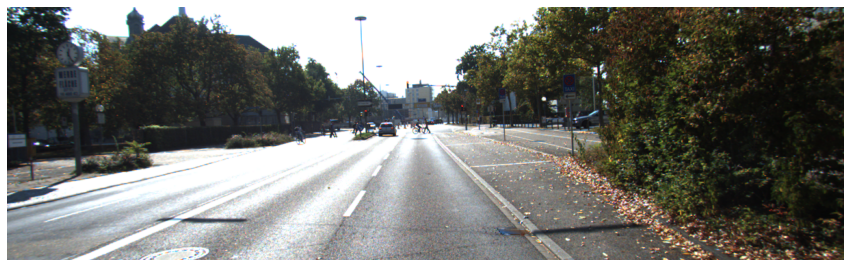

stop_3.png
box: [  0.      199.45767 314.24084 367.24814]
score: 0.71496505
label: 0
box: [757.5385  162.30478 884.85315 209.83275]
score: 0.4207703
label: 0
box: [747.9115  133.59299 900.7863  217.73022]
score: 0.15102558
label: 0


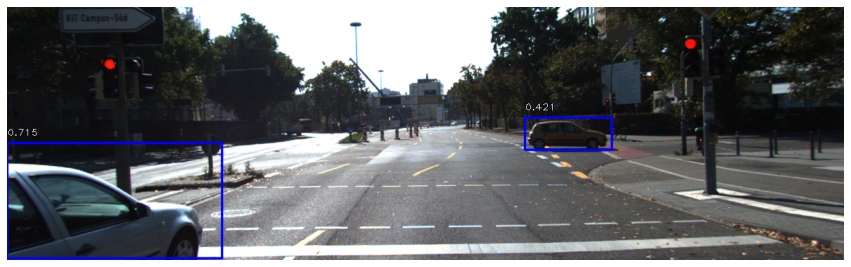

stop_4.png
box: [ 717.19946   91.04299 1071.1683   355.6579 ]
score: 0.33097196
label: 0
box: [ 754.27716  187.23123 1038.4288   363.27853]
score: 0.2749717
label: 0


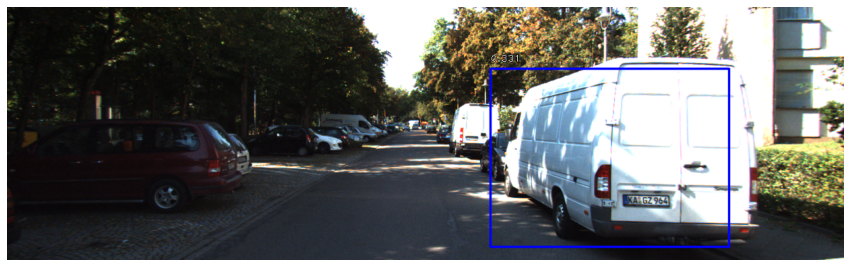

stop_1.png
box: [774.05774 148.45802 840.9801  309.82446]
score: 0.6078683
label: 1
box: [766.1164  150.93613 843.325   303.14734]
score: 0.16877495
label: 0


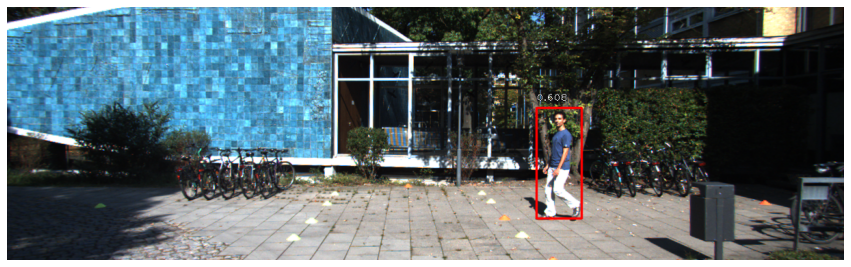

go_5.png
box: [ 10.051124 191.395    244.33957  307.4207  ]
score: 0.24523458
label: 0


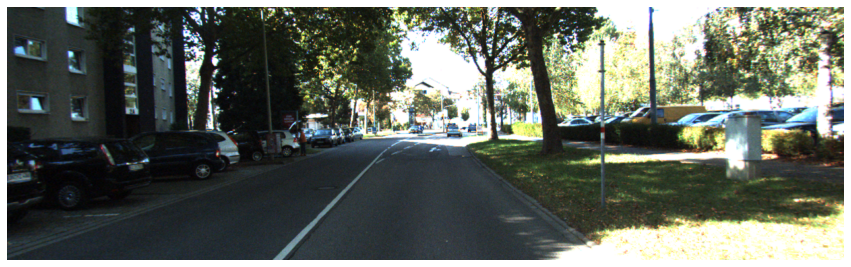

stop_2.png
box: [418.65976 165.71579 496.65778 333.7146 ]
score: 0.56915
label: 1
box: [415.21423 174.31871 500.57788 330.32516]
score: 0.24791689
label: 0


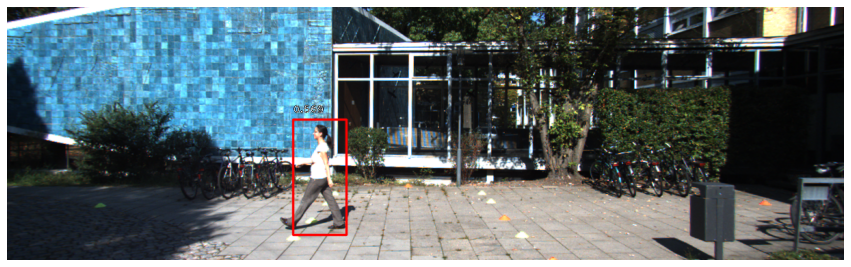

go_4.png
box: [695.80273 170.54253 789.76154 250.8625 ]
score: 0.5003097
label: 0
box: [680.1516  143.90611 809.6319  263.25494]
score: 0.12884207
label: 0


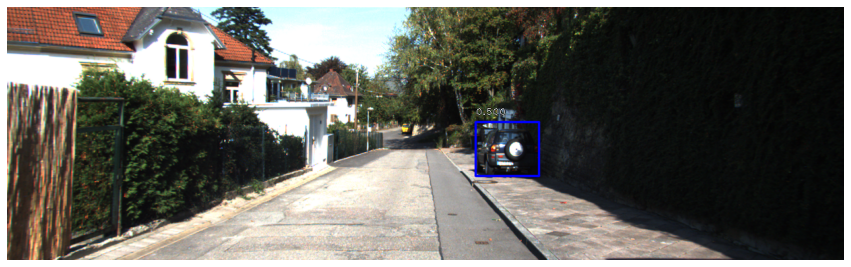

In [67]:
work_dir = os.getenv('HOME')+'/aiffel/object_detection/test_set/'
# work_dir 디렉토리에 있는 모든 파일(디렉토리) 리스트
file_list = os.listdir(work_dir)
# file_list에서 파일명이 .png로 끝나는 데이터만 file_list_png에 다시 정의
file_list_png = [file for file in file_list if file.endswith(".png")]

for image_file in file_list_png:
    print(image_file)
    image_path = work_dir + image_file
    # print(image_path)
    inference_on_image(model, img_path=image_path, limit_score=0.3)

#### limit_score=0.2

stop_5.png
box: [ 894.0435   189.20415 1241.0684   370.1611 ]
score: 0.486451
label: 0
box: [565.7537  178.36168 612.40344 216.80493]
score: 0.36258483
label: 0
box: [737.1734  163.96396 855.4426  242.52092]
score: 0.31953755
label: 0
box: [ 992.1412   133.3376  1241.0684   315.31183]
score: 0.15823211
label: 0


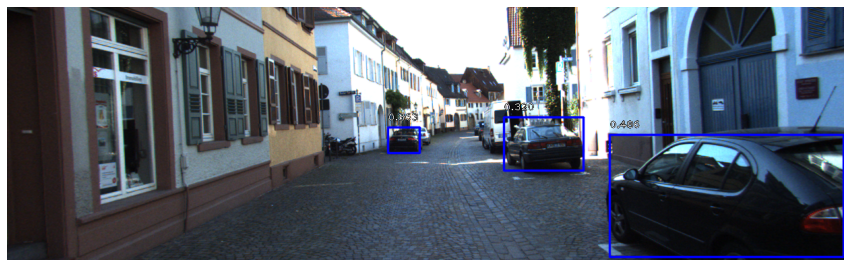

go_1.png
box: [594.1475  175.3645  624.5516  205.40355]
score: 0.612082
label: 0
box: [196.61952 131.23344 332.40222 233.99141]
score: 0.28354177
label: 0
box: [583.55365 173.5095  613.16864 203.23845]
score: 0.23342271
label: 0
box: [604.9146  174.56929 633.19653 204.22461]
score: 0.20913397
label: 0
box: [596.7321  168.0184  626.707   196.39116]
score: 0.1452497
label: 0


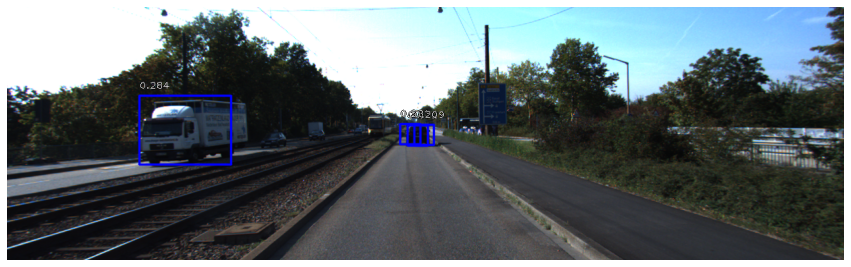

go_2.png
box: [625.46985 175.97823 666.6799  212.09056]
score: 0.6243944
label: 0
box: [517.93207 175.27269 570.73627 214.57968]
score: 0.20294568
label: 0
box: [611.6203  171.432   677.9782  219.76952]
score: 0.14805534
label: 0


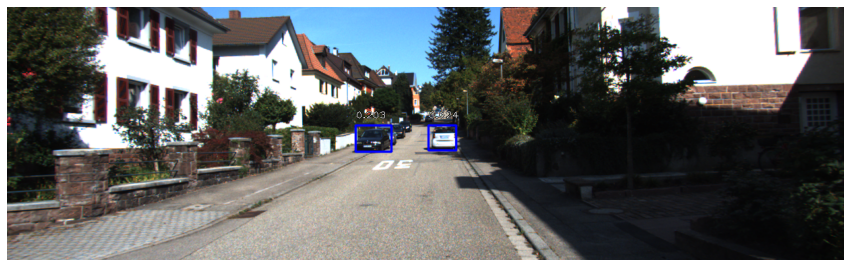

go_3.png
box: [547.80554 162.39705 574.1965  187.05312]
score: 0.19443947
label: 0


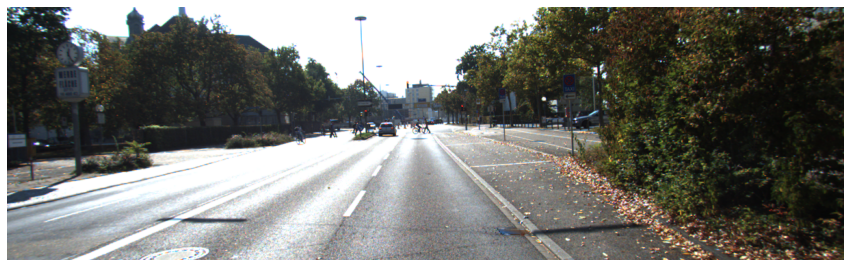

stop_3.png
box: [  0.      199.45767 314.24084 367.24814]
score: 0.71496505
label: 0
box: [757.5385  162.30478 884.85315 209.83275]
score: 0.4207703
label: 0
box: [747.9115  133.59299 900.7863  217.73022]
score: 0.15102558
label: 0


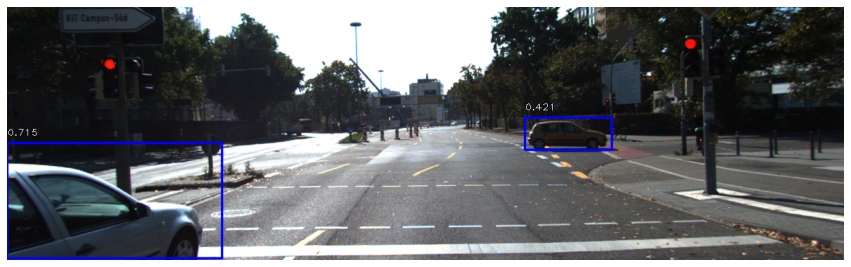

stop_4.png
box: [ 717.19946   91.04299 1071.1683   355.6579 ]
score: 0.33097196
label: 0
box: [ 754.27716  187.23123 1038.4288   363.27853]
score: 0.2749717
label: 0
box: [ 64.21973 161.2936  359.61087 319.0393 ]
score: 0.26245993
label: 0
box: [429.19208 167.2347  558.9503  215.69438]
score: 0.25053233
label: 0
box: [  8.74543 160.0707  257.61746 342.15305]
score: 0.22564764
label: 0
box: [710.6213  134.85857 974.51385 317.49603]
score: 0.16037378
label: 0


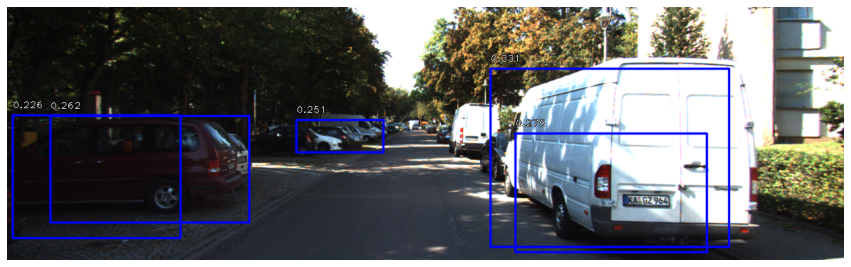

stop_1.png
box: [774.05774 148.45802 840.9801  309.82446]
score: 0.6078683
label: 1
box: [766.1164  150.93613 843.325   303.14734]
score: 0.16877495
label: 0


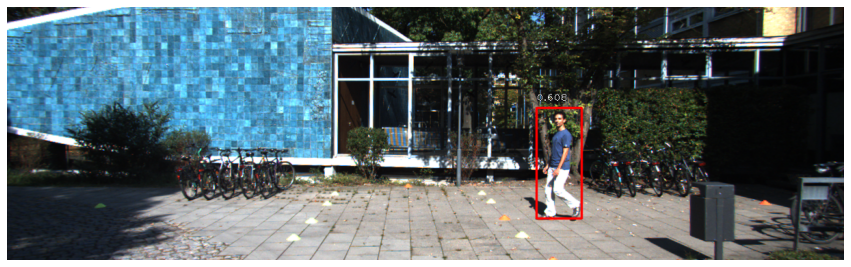

go_5.png
box: [ 10.051124 191.395    244.33957  307.4207  ]
score: 0.24523458
label: 0
box: [144.38655 182.50371 353.0387  263.49908]
score: 0.22215657
label: 0
box: [ 68.65524 186.97385 301.49136 286.35846]
score: 0.17415589
label: 0


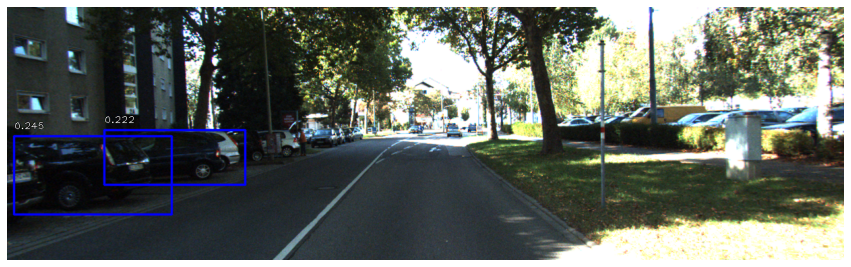

stop_2.png
box: [418.65976 165.71579 496.65778 333.7146 ]
score: 0.56915
label: 1
box: [415.21423 174.31871 500.57788 330.32516]
score: 0.24791689
label: 0
box: [384.09116 148.29521 517.1517  347.93933]
score: 0.15252806
label: 1


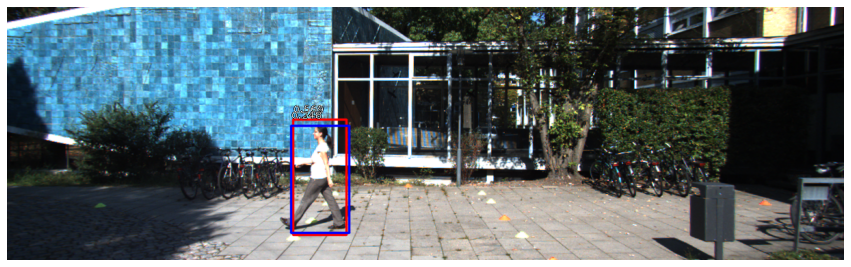

go_4.png
box: [695.80273 170.54253 789.76154 250.8625 ]
score: 0.5003097
label: 0
box: [680.1516  143.90611 809.6319  263.25494]
score: 0.12884207
label: 0


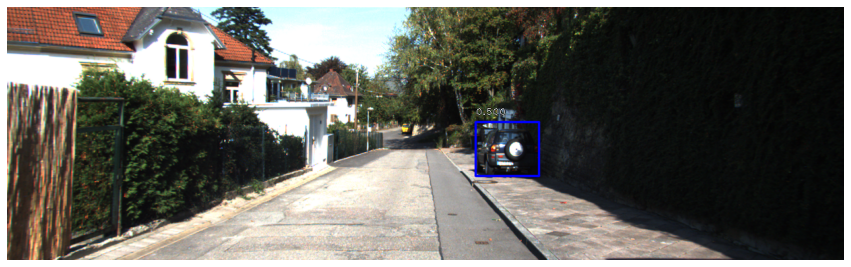

In [68]:
work_dir = os.getenv('HOME')+'/aiffel/object_detection/test_set/'
# work_dir 디렉토리에 있는 모든 파일(디렉토리) 리스트
file_list = os.listdir(work_dir)
# file_list에서 파일명이 .png로 끝나는 데이터만 file_list_png에 다시 정의
file_list_png = [file for file in file_list if file.endswith(".png")]

for image_file in file_list_png:
    print(image_file)
    image_path = work_dir + image_file
    # print(image_path)
    inference_on_image(model, img_path=image_path, limit_score=0.2)

## 1. 자율주행 시스템 만들기

위에서 만든 모델을 통해 아래의 조건을 만족하는 함수를 만들어 주세요.

* 입력으로 이미지 경로를 받습니다.
* **정지조건**에 맞는 경우 "Stop", 아닌 경우 "Go"를 반환합니다.
* 조건은 다음과 같습니다.
  - **사람이 한 명 이상 있는 경우**
  - **차량의 크기(width or height)가 300px이상인 경우**

In [69]:
img_path = os.getenv('HOME')+'/aiffel/object_detection/test_set/stop_1.png'

def self_drive_assist(img_path, size_limit=300, limit_score=0.5):
    # load image
    image = read_image_bgr(img_path)
    
    # preprocess image for network
    image = preprocess_image(image)
    image, scale = resize_image(image)
    
    # process image
    boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
    
    # correct for image scale
    boxes /= scale
    
    # Go/Stop conditions
    for box, score, label in zip(boxes[0], scores[0], labels[0]):
        # score 낮은 것은 무시
        if score < limit_score:
                break
                
        # 바운딩 박스의 크기        
        b = box.astype(int)
        b_width  = b[2] - b[0]
        b_height = b[3] - b[1]
        
        # 사람이 한 명 이상 있는 경우 "Stop"
        if label == 1 :
            return "Stop"
        # 차량의 크기(width or height)가 300px이상인 경우 "Stop"
        elif (b_width >= size_limit or b_height >= size_limit):
            return "Stop"
        # 그 이외의 경우 "Go"
        else: 
            return "Go"
   

print("Stop or Go ? :", self_drive_assist(img_path))

Stop or Go ? : Stop


* [참고: 자율주행 자동차에 대해서](https://seongkyun.github.io/blog/page5/)
* [참고: Semantic Segmentation for AutoDriving](https://junha1125.github.io/blog/artificial-intelligence/2020-05-04-seg-autoDriving1/)
* [참고: autonomous-driving](https://github.com/topics/autonomous-driving?l=python)
* [참고](https://ehdgns.tistory.com/114)

## 2. 자율주행 시스템 평가하기

아래 test_system() 를 통해서 위에서 만든 함수를 평가해봅시다.   
10장에 대해 Go와 Stop을 맞게 반환하는지 확인하고 100점 만점으로 평가해줍니다.

In [70]:
import os

def test_system(func):
    work_dir = os.getenv('HOME')+'/aiffel/object_detection'
    score = 0
    test_set=[
        ("test_set/stop_1.png", "Stop"),
        ("test_set/stop_2.png", "Stop"),
        ("test_set/stop_3.png", "Stop"),
        ("test_set/stop_4.png", "Stop"),
        ("test_set/stop_5.png", "Stop"),
        ("test_set/go_1.png", "Go"),
        ("test_set/go_2.png", "Go"),
        ("test_set/go_3.png", "Go"),
        ("test_set/go_4.png", "Go"),
        ("test_set/go_5.png", "Go"),
    ]

    print("파일 이름","\t\t", "예측","\t", "정답")
    for image_file, answer in test_set:
        image_path = work_dir + '/' + image_file
        
        pred = func(image_path, limit_score=0.2)
        
        print(image_file,"\t", pred,"\t", answer)
        
        if pred == answer:
            score += 10
    print()        
    print(f"{score}점입니다.")

test_system(self_drive_assist)

파일 이름 		 예측 	 정답
test_set/stop_1.png 	 Stop 	 Stop
test_set/stop_2.png 	 Stop 	 Stop
test_set/stop_3.png 	 Stop 	 Stop
test_set/stop_4.png 	 Stop 	 Stop
test_set/stop_5.png 	 Stop 	 Stop
test_set/go_1.png 	 Go 	 Go
test_set/go_2.png 	 Go 	 Go
test_set/go_3.png 	 None 	 Go
test_set/go_4.png 	 Go 	 Go
test_set/go_5.png 	 Go 	 Go

90점입니다.


* limit_score 값이 0.5 이상인 조건에서 예측이 None 으로 나온 경우 :
  - stop_4, stop_5, go_3, go_5
  
  
* limit_score 값이 0.4 이상인 조건에서 예측이 None 으로 나온 경우 :
  - stop_4,  go_3, go_5
  
  
* limit_score 값이 0.3 이상인 조건에서 예측이 None 으로 나온 경우 :
  - go_3, go_5  
  
  
* limit_score 값이 0.2 이상인 조건에서 예측이 None 으로 나온 경우 :
  - go_3

## 회고

* Keras RetinaNet의 github 내용을 확인하고 코드를 구현하려면 어떻게 해야하는지 더 배워야겠다.

* stop_1.png 와 stop_2.png 파일의 경우 사람과 자동차를 거의 같은 영역에서 검출하고 있다.
  - 이러한 경우에는 학습을 잘 못한 경우에 해당하는 것인지 의문이다.

* stop_4.png 와 go_5.png 파일의 경우 그늘에 있는 자동차의 검출 점수는 낮게 책정되었다.
  - 학습할 때 해당 데이터셋의 개수가 부족해서 그런것이 아닌가 생각한다.

